In [1]:
### Hayden Gallo
### Bucci Lab
### Monte Carlo Sensitivity Analysis to determine missing metabolites for Eubacterium limosum growth in RCM

import numpy as np
#from dfba import DfbaModel, ExchangeFlux, KineticVariable
import cobra
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
from numba import njit
from scipy.integrate import odeint
from scipy.integrate import solve_ivp
from scipy.optimize import least_squares
from scipy.optimize import curve_fit
from scipy.optimize import minimize
import sys
import os
import openpyxl
import gurobipy

import pymc as pm
import pytensor
import pytensor.tensor as pt
from pymc.ode import DifferentialEquation
from pytensor.compile.ops import as_op
import arviz as az

import time
import joblib
import multiprocessing
from scipy.stats import truncnorm
import copy
from pathlib import Path
import subprocess
from sklearn.metrics import *

from helper_functions import *


import plotly.express as px

In [2]:
### Ok here load the trace of the mcmc
main_directory = '/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/glv_fba_sim_analysis/test_54/'

trace_file_path = main_directory + 'trace.nc'
print(trace_file_path)
trace = az.from_netcdf(trace_file_path)
trace_summary = az.summary(trace)

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/glv_fba_sim_analysis/test_54/trace.nc


In [2]:
job_name = "MC_sensitivity_analysis"
base_output_dir = "/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA"
output_dir = base_output_dir + '/' + job_name
os.makedirs(output_dir, exist_ok=True)

In [49]:
cerillo_test_data = pd.read_csv('/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/dfba_comparative_analysis/cerillo_data_comp_analysis.csv', index_col=0)
averaged_cerillo_df_for_testing = cerillo_test_data.unstack().reset_index()
averaged_cerillo_df_for_testing.columns = ['Group_together', 'Time', 'OD']
cerillo_test_data = averaged_cerillo_df_for_testing


num_samples = 10
### Creating the 5 different sets of data EB_PC_co, PC_DO_co, EB_mono, PC_mono, DO_mono

### 1. co culture data of EB and PC

co_culture_df = cerillo_test_data[(cerillo_test_data['Group_together'] == 'PCwEUB') | (cerillo_test_data['Group_together'] == 'EUBwPC')]
EB_PC_co_culture_data = co_culture_df.pivot(index='Time', columns= 'Group_together', values = 'OD').reset_index()

### 2. mono culture data of EB

EB_mono_culture_df = cerillo_test_data[(cerillo_test_data['Group_together'] == 'EUB/EUB')]
EB_mono_culture_data = EB_mono_culture_df.pivot(index='Time', columns= 'Group_together', values = 'OD').reset_index()
EB_mono_culture_data['PC'] = 0

list_zero = EB_mono_culture_data['PC']
EB_mono_culture_data.insert(3, 'DO', list_zero)

### Add DO data to coculture of PC and EB

EB_PC_co_culture_data.insert(3, 'DO', list_zero)


### setting up the initial abundances

#init_abun_co_EB_PC = [.005, .005, 0]

EB_init_abun_mono = [.005, 0, 0]

init_abun = EB_init_abun_mono

### setup for the averaged data, use this data for getting weakly informative priors, then use non-averaged data in mcmc so we can get idea of uncertainty on predictions which can be propagated to 
### predictions about metabolites etc. 
#abun_list_priors = [init_abun_co_EB_PC, EB_init_abun_mono]
#microbe_data_list_priors = [EB_PC_co_culture_data,EB_mono_culture_data]
#dataset_names = ['EB_PC_co', 'EB_mono']

abun_list_priors = [ EB_init_abun_mono]
microbe_data_list_priors = [ EB_mono_culture_data]
dataset_names = [ 'EB_mono']
model_names = ['eb', 'p_copri', 'do']

In [4]:
trace_summary

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
r_1,0.674,0.011,0.641,0.680,0.003,0.003,29.0,21.0,1.24
r_2,0.319,0.058,0.146,0.341,0.018,0.013,29.0,21.0,1.24
r_3,0.440,0.002,0.437,0.445,0.001,0.000,29.0,21.0,1.24
gamma_EP,0.041,0.004,0.034,0.049,0.001,0.001,36.0,38.0,1.18
gamma_PE,0.007,0.081,-0.023,0.247,0.025,0.019,29.0,21.0,1.24
gamma_PD,0.043,0.122,0.000,0.407,0.039,0.028,29.0,21.0,1.24
gamma_DP,-0.072,0.006,-0.088,-0.064,0.002,0.001,29.0,21.0,1.24
a_1,-0.392,0.006,-0.396,-0.373,0.002,0.001,29.0,21.0,1.24
a_2,-0.250,0.096,-0.535,-0.211,0.030,0.022,29.0,21.0,1.24
a_3,-0.217,0.002,-0.222,-0.213,0.001,0.000,30.0,21.0,1.23


In [6]:
### Set up the params from the mean from the trace

# ED = 0
# DE = 0

#params = np.array([r_1, r_2, r_3, gamma_EP, gamma_ED, gamma_PE, gamma_PD, gamma_DE, gamma_DP, a_1, a_2, a_3])

params = np.array([trace_summary['mean'].loc['r_1'], trace_summary['mean'].loc['r_2'], trace_summary['mean'].loc['r_3'], trace_summary['mean'].loc['gamma_EP'], 0, trace_summary['mean'].loc['gamma_PE'],
                    trace_summary['mean'].loc['gamma_PD'], 0, trace_summary['mean'].loc['gamma_DP'], trace_summary['mean'].loc['a_1'], trace_summary['mean'].loc['a_2'], trace_summary['mean'].loc['a_3']])

In [7]:
p_copri_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panPrevotella_copri.mat')  
eb_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panEubacterium_limosum.mat') 
dorea_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panDorea_longicatena.mat')


Set parameter Username
Academic license - for non-commercial use only - expires 2025-05-28


No defined compartments in model model. Compartments will be deduced heuristically using regular expressions.
Using regular expression found the following compartments:c, e
No defined compartments in model model. Compartments will be deduced heuristically using regular expressions.
Using regular expression found the following compartments:c, e
No defined compartments in model model. Compartments will be deduced heuristically using regular expressions.
Using regular expression found the following compartments:c, e


In [4]:
#models = [eb_model, p_copri_model, dorea_model]
#models = [dorea_model, p_copri_model]


rcm_add = [['EX_adocbl(e)','0.01'],['EX_btn(e)','0.01'],['EX_h2s(e)','0.01'],['EX_ribflv(e)', '0.01'],['EX_thymd(e)', '0.01'],['EX_thm(e)', '0.01'],['EX_spmd(e)', '0.01'],['EX_sheme(e)', '0.01'],['EX_q8(e)', '0.01'],['EX_pheme(e)', '0.01'],['EX_fol(e)', '0.01'],['EX_2dmmq8(e)', '0.01'],['EX_26dap_M(e)', '0.01'],['EX_cobalt2(e)', '0.01'],['EX_cu2(e)', '0.01'],['EX_fe3(e)', '0.01'],['EX_mn2(e)', '0.01'],['EX_zn2(e)', '0.01'],['EX_na1(e)', '49.13878039'],['EX_cl(e)', '35.42367951'],['EX_n2(e)', '221.9285714'],['EX_ca2(e)', '0.083087978'],['EX_fe2(e)', '0.009273883'],['EX_mg2(e)', '0.216827813'],['EX_k(e)', '10.45186108'],['EX_so4(e)', '0.913009078'],['EX_pi(e)', '4.844687796'],['EX_ala_L(e)', '16.70146138'],['EX_arg_L(e)', '5.384491745'],['EX_asn_L(e)', '0.908272088'],['EX_asp_L(e)', '9.083395943'],['EX_glu_L(e)', '17.32518669'],['EX_gly(e)', '25.44393675'],['EX_his_L(e)', '2.120432852'],['EX_ile_L(e)', '6.174957118'],['EX_leu_L(e)', '9.323422908'],['EX_lys_L(e)', '7.168752993'],['EX_met_L(e)', '1.702321591'],['EX_phe_L(e)', '5.193956124'],['EX_pro_L(e)', '11.3782441'],['EX_ser_L(e)', '3.882275699'],['EX_thr_L(e)', '2.837474815'],['EX_trp_L(e)', '0.56309339'],['EX_tyr_L(e)', '1.357683329'],['EX_val_L(e)', '7.89599481'], ['EX_Lcystin(e)', '0.108201688'], ['EX_gln_L(e)', '0.109479562'],['EX_glc_D(e)', '27.75372455'],['EX_cys_L(e)', '2.846894039'],['EX_M02144(e)', '2.846894039'],['EX_h2o(e)', '55509.29781'],['EX_h(e)', '0.000158489']]

rcm_add = pd.DataFrame(rcm_add)

rcm_add.columns = ['reaction','fluxValue']
rcm_add['fluxValue'] =  np.double(rcm_add['fluxValue'])

time_integration = np.linspace(0, 24,577)


# total sim time should be in hours....
#glv_out = odeint(generalized_gLV, y0 = init_abun, t=time_integration, args = (params,))
#glv_out = odeint(multi_spec_gLV, y0 = EB_init_abun_mono, t=time_integration, args  =(params,))
#print(glv_out)



In [50]:
import time

i = 250

if (i%250 == 0 and i != 0):
    time.sleep(10)
    print('yes')
else:
    print('no')

no


In [222]:
samples = truncnorm.rvs((0-50)/0.1,(np.inf-50)/0.1,loc = 50, scale=0.1, size = 1000)

# here need to specify in a list the mets to vary

#mets_to_vary = ['EX_fe2(e)']
mets_to_vary = rcm_add['reaction'].to_list()


In [223]:
def draw_met_conc(media_df, num_samples):

    mets_draws_dict = {}
    mets_draws_array = np.zeros([len(media_df),num_samples])

    for i in range(0, len(media_df)):
        
        rxn_name = media_df.iloc[i,0]
        rxn_flux = media_df.iloc[i,1]
        # for now lets just make the sd 5% of what was supplied 

        if rxn_name in mets_to_vary:
            five_pct_rxn_flux = rxn_flux * 0.05

            if rxn_flux == 0.01:
                samples = np.random.uniform(0.01,0.1,num_samples)
            else:
                samples = truncnorm.rvs((0-rxn_flux)/five_pct_rxn_flux,(np.inf-rxn_flux)/five_pct_rxn_flux,loc = rxn_flux, scale=five_pct_rxn_flux, size = num_samples)

            # convert samples array to a list to be stored in the dict   
            samples = samples.tolist()
            mets_draws_dict[rxn_name] = samples
            mets_draws_array[i,:] = samples
        
        else:

            samples = [rxn_flux] * num_samples
            mets_draws_dict[rxn_name] = samples
            mets_draws_array[i,:] = samples


    mets_draws_df = pd.DataFrame(mets_draws_array)
    mets_draws_df.index = media_df['reaction']

    return mets_draws_dict, mets_draws_df

In [224]:
mets_draws_dict, mets_draw_df = draw_met_conc(rcm_add,num_samples)
mets_draw_df

,0,1,2,3,4,5,6,7,8,9
reaction,,,,,,,,,,
EX_adocbl(e),0.097463,0.031488,0.076152,0.024667,0.032675,0.022687,0.023111,0.082733,0.021318,0.076200
EX_btn(e),0.075627,0.028122,0.015806,0.099190,0.062082,0.033546,0.018168,0.084246,0.039282,0.059746
EX_h2s(e),0.039680,0.059062,0.067564,0.085198,0.031581,0.054172,0.081740,0.076775,0.062647,0.073167
EX_ribflv(e),0.018219,0.068871,0.025767,0.022068,0.038575,0.065388,0.032884,0.075598,0.032248,0.050659
EX_thymd(e),0.080475,0.077978,0.067241,0.025851,0.028975,0.026752,0.029434,0.080523,0.066994,0.066021
EX_thm(e),0.055167,0.031489,0.042022,0.079908,0.085350,0.031253,0.086401,0.036985,0.026428,0.058247
EX_spmd(e),0.045742,0.040864,0.022224,0.021792,0.017710,0.017231,0.019687,0.065028,0.097275,0.085280
EX_sheme(e),0.042337,0.029720,0.061243,0.071397,0.083640,0.098154,0.049390,0.050467,0.011810,0.085938
EX_q8(e),0.013507,0.094459,0.095186,0.043510,0.089510,0.071201,0.012571,0.045439,0.071571,0.054420


In [19]:
param_df_name = job_save_dir + '/MC_param_df'

np.save(os.path.join(param_df_name), mets_draw_df)

In [31]:
save_to_pickle = param_df_name + '.pkl'

mets_draw_df.to_pickle(save_to_pickle)

In [32]:
loaded_pkl = pd.read_pickle(save_to_pickle)

In [21]:
test = np.load(file='/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_test_1/MC_param_df.npy')

In [28]:
test_array = np.load(file='/Users/haydengallo/Downloads/MC_param_array.npy', allow_pickle=True)

In [14]:
job_name = 'EB_test_1'
unique_job_name = f"{job_name}"
job_save_dir = os.path.join(output_dir, unique_job_name)
os.makedirs(job_save_dir, exist_ok=True)
print(job_save_dir)

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_test_1


In [40]:

#### here I need to specify the index because DO would be in [:,2]

for i in range(0, len(mets_draw_df.columns)):

    sim_name = 'sim'
    unique_job_name = f"{sim_name}_{i}"
    sim_save_dir = os.path.join(job_save_dir, unique_job_name)
    os.makedirs(sim_save_dir, exist_ok=True)



    rcm_add = pd.DataFrame(zip(mets_draw_df.index, mets_draw_df.iloc[:,i]))
    rcm_add.columns = ['reaction','fluxValue']
    rcm_add['fluxValue'] =  np.double(rcm_add['fluxValue'])
    


    met_pool_over_time, model_abun_dict = static_dfba(list_model_names=model_names,list_models=models, initial_abundance=init_abun, total_sim_time=(24), num_t_steps=(576), glv_out=glv_out, glv_params=params, environ_cond= rcm_add, pfba=True)

    met_pool_filename = "met_pool_over_time.npy"
    model_abun_filename = "model_abun_dict.npy"


    # Save the results to the specified save path
    np.save(os.path.join(sim_save_dir, met_pool_filename), met_pool_over_time)
    np.save(os.path.join(sim_save_dir, model_abun_filename), model_abun_dict)

Time step:  0
[0.0033602000000000007, 0.0, 0.0]
Bacteria is: eb
Status of pfba: optimal
pfba <Solution 3.096 at 0x17df236b0>
Upper_bound: 0.0033602000000000007
Print medium used for optimization: {'EX_26dap_M(e)': 0.07432487655566158, 'EX_2dmmq8(e)': 0.07872263563870911, 'EX_adocbl(e)': 0.01853215563328217, 'EX_ala_L(e)': 16.828388749193365, 'EX_arg_L(e)': 5.322857102922575, 'EX_asn_L(e)': 0.8531987370563433, 'EX_asp_L(e)': 8.706233450262769, 'EX_btn(e)': 0.05262143084102393, 'EX_ca2(e)': 0.08114978287102748, 'EX_cl(e)': 36.63819329141734, 'EX_cobalt2(e)': 0.09223383765581887, 'EX_cu2(e)': 0.08646495777220907, 'EX_cys_L(e)': 2.793618160134925, 'EX_fe2(e)': 0.009037923170261733, 'EX_fe3(e)': 0.020096290437672616, 'EX_fol(e)': 0.05425366867387346, 'EX_glc_D(e)': 28.47802876902915, 'EX_glu_L(e)': 16.961403916215005, 'EX_gly(e)': 26.028262415346077, 'EX_h(e)': 0.00016731673402941102, 'EX_h2o(e)': 54742.60748265411, 'EX_his_L(e)': 2.1448769391446003, 'EX_ile_L(e)': 6.397779045291201, 'EX_k(

In [12]:
### Nevermind cannot parallelize this way, must batch jobs out on the hpc because need to load model into memory every time but separately
'''
def parallel_dfba_MC(i):
    sim_name = 'sim'
    unique_job_name = f"{sim_name}_{i}"
    sim_save_dir = os.path.join(job_save_dir, unique_job_name)
    os.makedirs(sim_save_dir, exist_ok=True)

    p_copri_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panPrevotella_copri.mat')  
    eb_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panEubacterium_limosum.mat') 
    dorea_model = cobra.io.load_matlab_model('/Users/haydengallo/cobratoolbox/panSpeciesModels/panDorea_longicatena.mat')



    rcm_add = pd.DataFrame(zip(mets_draw_df.index, mets_draw_df.iloc[:,i]))
    rcm_add.columns = ['reaction','fluxValue']
    rcm_add['fluxValue'] =  np.double(rcm_add['fluxValue'])
    


    met_pool_over_time, model_abun_dict = static_dfba(list_model_names=model_names,list_models=models, initial_abundance=init_abun, total_sim_time=(24), num_t_steps=(576), glv_out=glv_out, glv_params=params, environ_cond= rcm_add, pfba=True)

    met_pool_filename = "met_pool_over_time.npy"
    model_abun_filename = "model_abun_dict.npy"


    # Save the results to the specified save path
    np.save(os.path.join(sim_save_dir, met_pool_filename), met_pool_over_time)
    np.save(os.path.join(sim_save_dir, model_abun_filename), model_abun_dict)

### cannot parallelize this way probably better just to implement as a batch
print(joblib.Parallel(n_jobs = -1, prefer='threads')(joblib.delayed(parallel_dfba_MC)(i) for i in range(len(mets_draw_df.columns))))      

'''

In [5]:
### Ok here analyze results of Monte Carlo sensitivity analysis 

MC_directory = '/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1'



In [6]:
### read in MC data

### Reading in all of the data from the simulation 

abun_to_store =[]
#met_to_store =[]
temp_abun = []
#temp_met =[]


for i in range(0,500):
    
    temp_dir = MC_directory + '/sim_' + str(i)
    print(temp_dir)
    if os.path.exists(temp_dir):
        #met = temp_dir + '/met_pool_over_time.npy'
        abun = temp_dir + '/model_abun_dict.npy'
        #met = np.load(met, allow_pickle=True)
        abun = np.load(abun, allow_pickle=True)
        #temp_met.append(met)
        temp_abun.append(abun.item())
abun_to_store.append(temp_abun)
#met_to_store.append(temp_met)  

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_0
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_1
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_2
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_3
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_4
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_5
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_6
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/sim_7
/Users/haydengal

In [7]:
### read in MC data
### ok so luckily i just need to read in the RMSE from individual .csv files 
### Reading in all of the data from the simulation 

rmse_dict = {}
rmse_list_correct_len = []
rmse_list_reduced = []

for i in range(0,5000):
    
    csv_file_name = MC_directory + '/rmse_eb_mono/rmse_sim_' + str(i) + '.csv'
    if os.path.exists(csv_file_name):
        test = pd.read_csv(csv_file_name)
        temp_rmse = float(test.columns.to_list()[0])
        rmse_list_correct_len.append(temp_rmse)
        rmse_list_reduced.append(temp_rmse)
        rmse_dict[str(i)] = temp_rmse
    else:
        rmse_list_correct_len.append('no')
        rmse_dict[str(i)] = 'no'   


In [8]:
### read in MC data for co_culture
### ok so luckily i just need to read in the RMSE from individual .csv files 
### Reading in all of the data from the simulation 

rmse_dict_pc_co = {}
rmse_dict_eb_co = {} 
rmse_list_correct_len_pc_co = []
rmse_list_correct_len_eb_co = []
rmse_list_reduced_eb_co = []
rmse_list_reduced_pc_co =[]


for i in range(0,5000):
    
    csv_file_name = MC_directory + '/rmse_eb_pc_co/rmse_sim_' + str(i) + '.csv'
    if os.path.exists(csv_file_name):
        test = pd.read_csv(csv_file_name, header=None)
        temp_rmse = float(test.iloc[0,0])
        #rmse_list_correct_len.append(temp_rmse)
        rmse_list_reduced_eb_co.append(temp_rmse)
        rmse_dict_eb_co[str(i)] = temp_rmse
        temp_rmse = float(test.iloc[1,0])
        rmse_list_reduced_pc_co.append(temp_rmse)
        rmse_dict_pc_co[str(i)] = temp_rmse
    else:
        rmse_list_correct_len_pc_co.append('no')
        rmse_list_correct_len_eb_co.append('no')
        rmse_dict_pc_co[str(i)] = 'no' 
        rmse_dict_eb_co[str(i)] = 'no'   


In [9]:
mets_path = MC_directory + '/MC_param_df.pkl'

met_draws = pd.read_pickle(mets_path)

In [10]:
len(rmse_list_reduced_pc_co)

4818

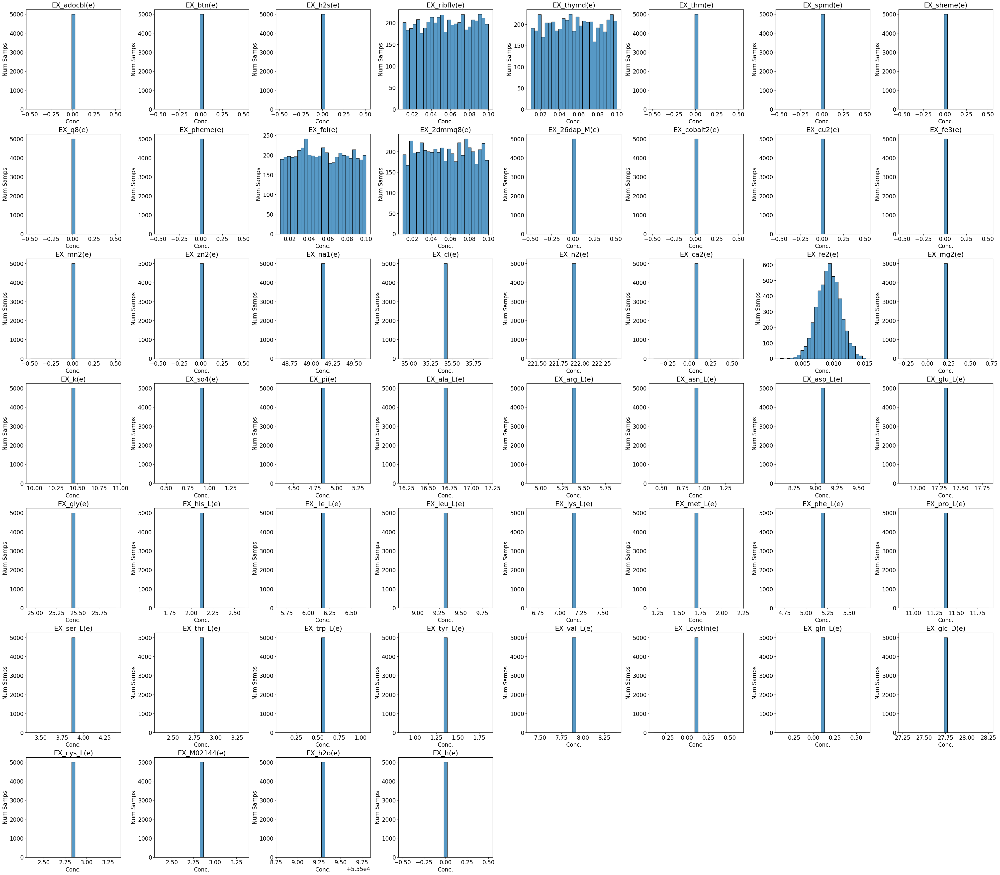

In [11]:
### Probably should just save FBA abundance overtime as separate .npy so as not to need to load in 1000 abun_dict at same time

## nevermind should just calculate RMSE directly after 
#['DO_mono', 'DO_PC_co', 'EB_mono', 'EB_PC_co', 'PC_mono']
plt.rcParams.update({'lines.linewidth': 4})
plt.rcParams.update({'font.size': 16})

## Ok here should make a plot of the histogram 

num_plots = len(met_draws.index)
cols = 8  # Number of columns in the grid
rows = (num_plots + cols - 1) // cols  # Calculate number of rows needed

fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i in range(num_plots):
    column_name = met_draws.index[i]
    #abs_values = np.abs(p_copri_meta_butyrate_producers.iloc[:, i])
    

    # Scatter plot on the respective subplot
    sns.histplot(ax=axes[i], data=met_draws.iloc[i,:], bins=25)
    
    axes[i].set_title(column_name)
    axes[i].set_xlabel('Conc.')
    axes[i].set_ylabel('Num Samps')

# Hide any empty subplots if the number of plots is not a perfect square
for j in range(num_plots, len(axes)):
    fig.delaxes(axes[j])

plt.show()







In [231]:
#eb_array_fba_biomass = np.zeros([len(abun_to_store[0][0]['eb']['fba_biomass']), 500])

IndexError: list index out of range

In [19]:
#for i in range(0, 500):
#    eb_array_fba_biomass[:,i] = abun_to_store[0][i]['eb']['fba_biomass']


In [251]:
# once counter gets to 280 stop
# old 

'''ArithmeticError
all_rmse =[]

for j in range(0,500):

    counter = 0 
    sim_name = 'sim_' + str(j)

    test_list = []

    for i in range(0, len(eb_array_fba_biomass[:,j])):
        if counter == 280:
            break
        if i%2 == 0:
            test_list.append(eb_array_fba_biomass[i,j])
            counter += 1


    rmse_temp = root_mean_squared_error(EB_mono_culture_df['OD'].to_list(), test_list)
    rmse_dict[sim_name] = rmse_temp
    all_rmse.append(rmse_temp)
    

'''

IndexError: index 500 is out of bounds for axis 1 with size 500

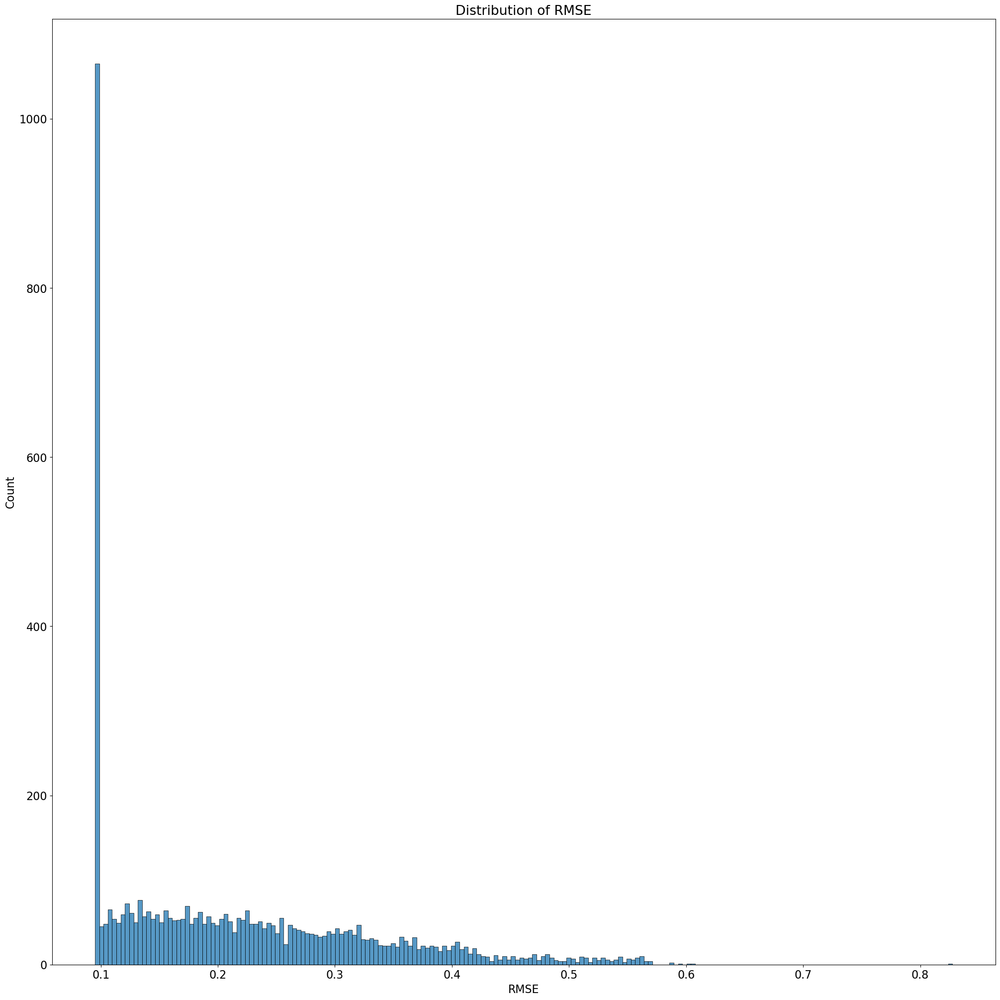

In [12]:
fig, axes = plt.subplots(1, 1, figsize=(20,20), constrained_layout=True)
sns.histplot(data=rmse_list_reduced, bins = 200)
axes.set_title('Distribution of RMSE')
axes.set_xlabel('RMSE')
axes.set_ylabel('Count')
#axes[i].set_title(column_name)
#axes[i].set_xlabel('Conc.')
#axes[i].set_ylabel('Num Samps')

plt.show()

In [13]:
sim_rmse_df = pd.DataFrame.from_dict(rmse_dict, orient='index').reset_index()
sim_rmse_df.columns = ['sim_num', 'rmse']

In [14]:
# ok now what's the best way to plot the difference in initial conditions verses the rmse 

### maybe i should plot correlation plots with differences of specific metabolites vs the rmse see if there is a correlation between any of them 

## ok so loop through each and then 

mets_diff_df = met_draws.copy()
mets_percent_diff_df = met_draws.copy()
#mets_diff_df = mets_diff_df.iloc[:,:500]

for i in range(0, 5000):

    mets_diff_df.iloc[:,i] = np.double(met_draws.iloc[:,i]) - rcm_add['fluxValue']
    mets_percent_diff_df.iloc[:,i] = np.abs(rcm_add['fluxValue'] - np.double(met_draws.iloc[:,i]))/(rcm_add['fluxValue'])


In [15]:
### ok so now that some of the sims didn't work need to filter correctly:

### well in 7250 only one sim failed, 368
mets_diff_df_filtered = mets_diff_df.iloc[:,sim_rmse_df[sim_rmse_df['rmse'] != 'no'].index.to_list()]
mets_percent_diff_df_filt = mets_percent_diff_df.iloc[:,sim_rmse_df[sim_rmse_df['rmse'] != 'no'].index.to_list()]


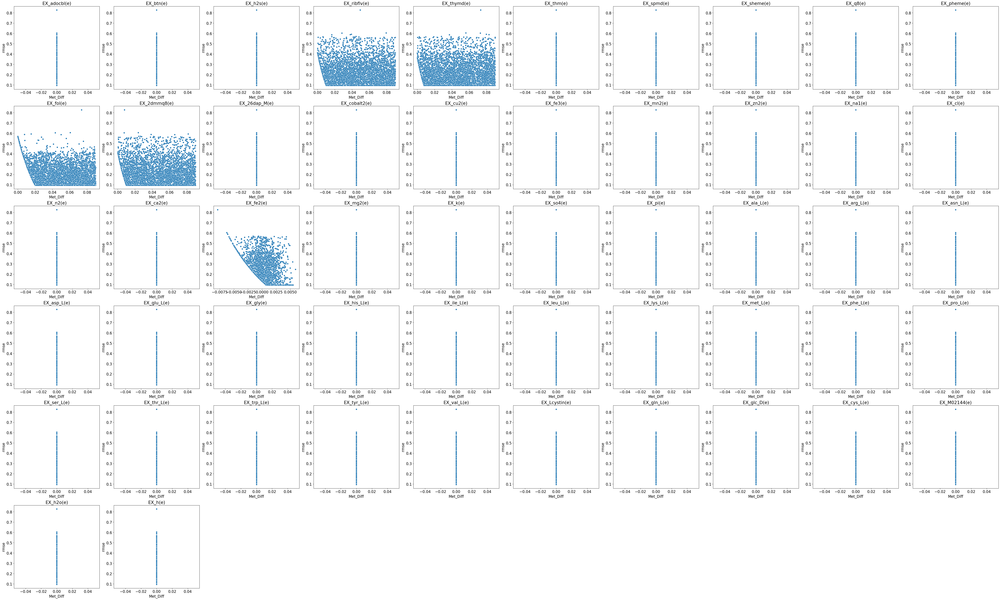

In [16]:
num_plots = len(met_draws.index)
cols = 10  # Number of columns in the grid
rows = (num_plots + cols - 1) // cols  # Calculate number of rows needed

fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows *6), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i in range(num_plots):
    column_name = met_draws.index[i]
    
    #F_prau_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 60])[1, 0]
    #R_faecis_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 61])[1, 0]
    #E_hallii_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 62])[1, 0]

    # Scatter plot on the respective subplot
    sns.scatterplot(ax=axes[i],  
                    x=mets_diff_df_filtered.iloc[i,:], y=rmse_list_reduced)
    
    axes[i].set_title(column_name)
    axes[i].set_xlabel('Met_Diff')
    axes[i].set_ylabel('rmse')


# Hide any empty subplots if the number of plots is not a perfect square
for j in range(num_plots, len(axes)):
    fig.delaxes(axes[j])

plt.show()

In [17]:
# ok filter met_draws by only ones of interest
# 
rxn_filter_list =['EX_ribflv(e)' , 'EX_thymd(e)', 'EX_fol(e)', 'EX_2dmmq8(e)', 'EX_fe2(e)']

met_draws_filt = met_draws[met_draws.index.isin(rxn_filter_list)]


In [18]:
mets_diff_df_filter_only_five = mets_diff_df_filtered[mets_diff_df_filtered.index.isin(rxn_filter_list)]

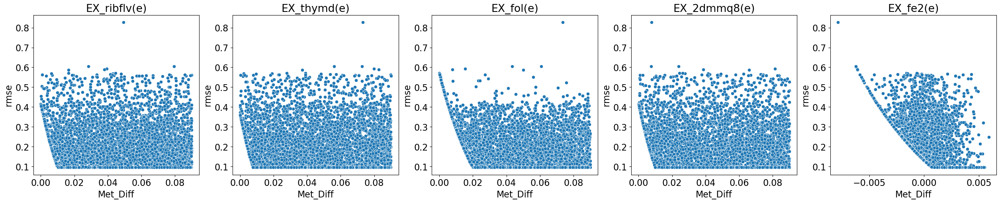

In [19]:
num_plots = len(met_draws_filt.index)
cols = 5  # Number of columns in the grid
rows = (num_plots + cols - 1) // cols  # Calculate number of rows needed

fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i in range(num_plots):
    column_name = met_draws_filt.index[i]
    
    #F_prau_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 60])[1, 0]
    #R_faecis_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 61])[1, 0]
    #E_hallii_corr = np.corrcoef(abs_values, p_copri_meta_butyrate_producers.iloc[:, 62])[1, 0]

    # Scatter plot on the respective subplot
    sns.scatterplot(ax=axes[i],  
                    x=mets_diff_df_filter_only_five.iloc[i,:], y=rmse_list_reduced)
    
    axes[i].set_title(column_name)
    axes[i].set_xlabel('Met_Diff')
    axes[i].set_ylabel('rmse')


# Hide any empty subplots if the number of plots is not a perfect square
for j in range(num_plots, len(axes)):
    fig.delaxes(axes[j])

plt.show()

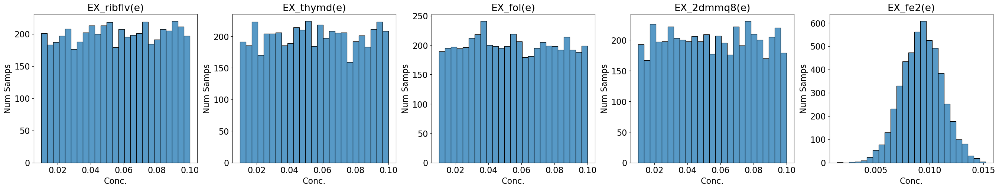

In [20]:
### Probably should just save FBA abundance overtime as separate .npy so as not to need to load in 1000 abun_dict at same time

## nevermind should just calculate RMSE directly after 
#['DO_mono', 'DO_PC_co', 'EB_mono', 'EB_PC_co', 'PC_mono']
plt.rcParams.update({'lines.linewidth': 4})
plt.rcParams.update({'font.size': 16})

## Ok here should make a plot of the histogram 

num_plots = len(met_draws_filt.index)
cols = 8  # Number of columns in the grid
rows = (num_plots + cols - 1) // cols  # Calculate number of rows needed

fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i in range(num_plots):
    column_name = met_draws_filt.index[i]
    #abs_values = np.abs(p_copri_meta_butyrate_producers.iloc[:, i])
    

    # Scatter plot on the respective subplot
    sns.histplot(ax=axes[i], data=met_draws_filt.iloc[i,:], bins=25)
    
    axes[i].set_title(column_name)
    axes[i].set_xlabel('Conc.')
    axes[i].set_ylabel('Num Samps')

# Hide any empty subplots if the number of plots is not a perfect square
for j in range(num_plots, len(axes)):
    fig.delaxes(axes[j])

plt.show()



In [533]:
# ok here pull out the 10 lowest RMSE

## Ok here grabs the top N 

num_samps_to_grab = 10

samps_df_list = sim_rmse_df.sort_values('rmse')['sim_num'][:num_samps_to_grab].to_list()

TypeError: '<' not supported between instances of 'str' and 'float'

In [524]:
### read in MC data

### Reading in all of the data from the simulation 

abun_to_store =[]
#met_to_store =[]
temp_abun = []
#temp_met =[]

npy_dir = '/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_test_fe2_ribflv_thymd_fol_2dmmq8_2'

for i in samps_df_list:
    
    temp_dir = npy_dir + '/sim_' + str(i)
    print(temp_dir)
    if os.path.exists(temp_dir):
        #met = temp_dir + '/met_pool_over_time.npy'
        abun = temp_dir + '/model_abun_dict.npy'
        #met = np.load(met, allow_pickle=True)
        abun = np.load(abun, allow_pickle=True)
        #temp_met.append(met)
        temp_abun.append(abun.item())
abun_to_store.append(temp_abun)
#met_to_store.append(temp_met)  

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_test_fe2_ribflv_thymd_fol_2dmmq8_2/sim_388


KeyboardInterrupt: 

In [348]:
eb_array_fba_biomass = np.zeros([len(abun_to_store[0][0]['eb']['fba_biomass']),len(abun_to_store[0])])

for i in range(0, len(abun_to_store[0])):
    eb_array_fba_biomass[:,i] = abun_to_store[0][i]['eb']['fba_biomass']

In [353]:
time_integration = np.linspace(0, 24,577)

abun_to_store[0] length: 10
eb_array_fba_biomass shape: (577, 10)
Column 0 min: 0.005, max: 1.5913883297418474
Column 1 min: 0.005, max: 1.591387399048767
Column 2 min: 0.005, max: 1.59138658922618
Column 3 min: 0.005, max: 1.5913864619970357
Column 4 min: 0.005, max: 1.5913864619970357
Column 5 min: 0.005, max: 1.5913864619970357
Column 6 min: 0.005, max: 1.5913864619970357
Column 7 min: 0.005, max: 1.5913864619970357
Column 8 min: 0.005, max: 1.5913864619970357
Column 9 min: 0.005, max: 1.5913865840544716


<>:4: SyntaxWarning: invalid escape sequence '\i'
<>:22: SyntaxWarning: invalid escape sequence '\i'
<>:4: SyntaxWarning: invalid escape sequence '\i'
<>:22: SyntaxWarning: invalid escape sequence '\i'
/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_22881/2299281077.py:4: SyntaxWarning: invalid escape sequence '\i'
  ax.plot(EB_mono_culture_df['Time'], EB_mono_culture_df['OD'], label='Mean $\it{E. limosum}$ Abun')
/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_22881/2299281077.py:22: SyntaxWarning: invalid escape sequence '\i'
  ax.set_title('Mean from Posterior vs. $\it{E. limosum}$ \n mono Abundance Data')


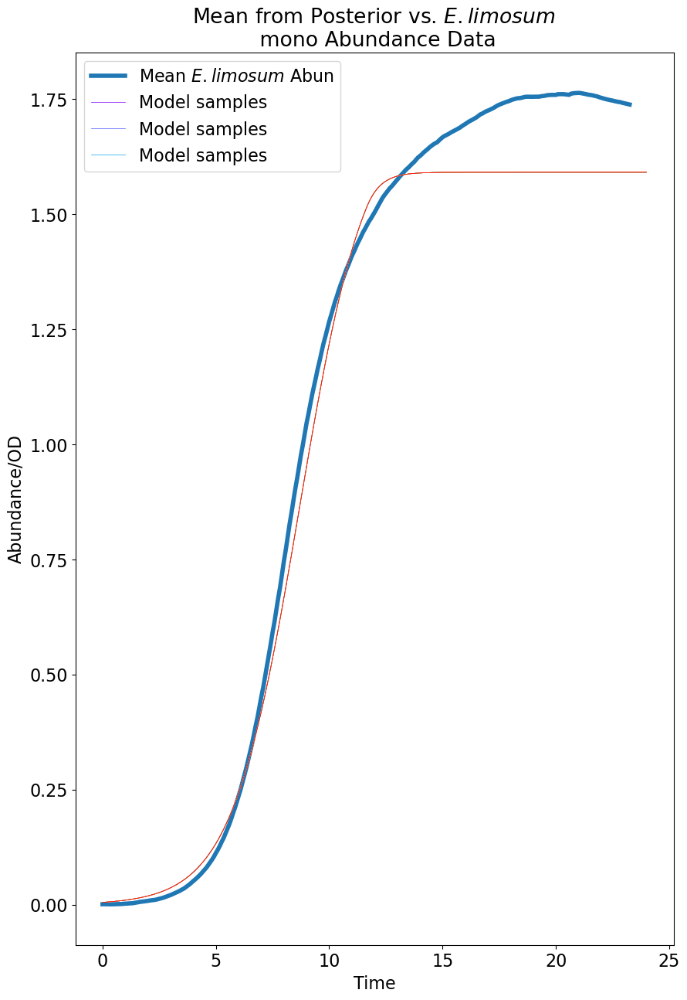

In [363]:
fig, ax = plt.subplots(figsize=(10, 15))

# Plot the first line (mono culture data)
ax.plot(EB_mono_culture_df['Time'], EB_mono_culture_df['OD'], label='Mean $\it{E. limosum}$ Abun')

# Print the shapes to diagnose the issue
print(f"abun_to_store[0] length: {len(abun_to_store[0])}")
print(f"eb_array_fba_biomass shape: {eb_array_fba_biomass.shape}")

# Plot each column of eb_array_fba_biomass with different colors
colors = plt.cm.rainbow(np.linspace(0, 1, eb_array_fba_biomass.shape[1]))

for i in range(eb_array_fba_biomass.shape[1]):
    label = samps_df_list[i] if i < len(samps_df_list) else f"Sample {i}"
    ax.plot(time_integration, eb_array_fba_biomass[:, i], 
            label=label, color=colors[i], lw=0.5)
    
    # Print range of values to help diagnose
    print(f"Column {i} min: {eb_array_fba_biomass[:, i].min()}, max: {eb_array_fba_biomass[:, i].max()}")

# Add proper labels
ax.set_title('Mean from Posterior vs. $\it{E. limosum}$ \n mono Abundance Data')
ax.set_xlabel('Time')
ax.set_ylabel('Abundance/OD')

# Add legend for only a few lines to avoid overcrowding
handles, labels = ax.get_legend_handles_labels()
if len(handles) > 10:
    ax.legend([handles[0]] + handles[1:4], [labels[0]] + ["Model samples"] * 3)
else:
    ax.legend()

plt.show()



### so at some point the fit/rmse degrades/reaches level of gLV, gLV is floor 


In [21]:
# Ok so yeah maybe a pareto curve is what i am looking for here
# claude gave me pareto curve idea

# construct percent change vs rmse dataframe and plot curve 

mets_percent_diff_sum = mets_percent_diff_df_filt.sum()
mets_percent_diff_sum_df = pd.DataFrame(mets_percent_diff_sum)
mets_percent_diff_sum_df['rmse'] = rmse_list_reduced
mets_percent_diff_sum_df.columns = ['init_cond_p_ch', 'rmse']
mets_percent_diff_sum_df['sim_num'] = mets_percent_diff_sum_df.index
mets_percent_diff_sum_df.head()

,init_cond_p_ch,rmse,sim_num
0,20.001766,0.095041,0
1,21.115250,0.180621,1
2,13.862912,0.106871,2
3,22.031903,0.097047,3
4,18.288668,0.482424,4


Text(0, 0.5, 'RMSE')

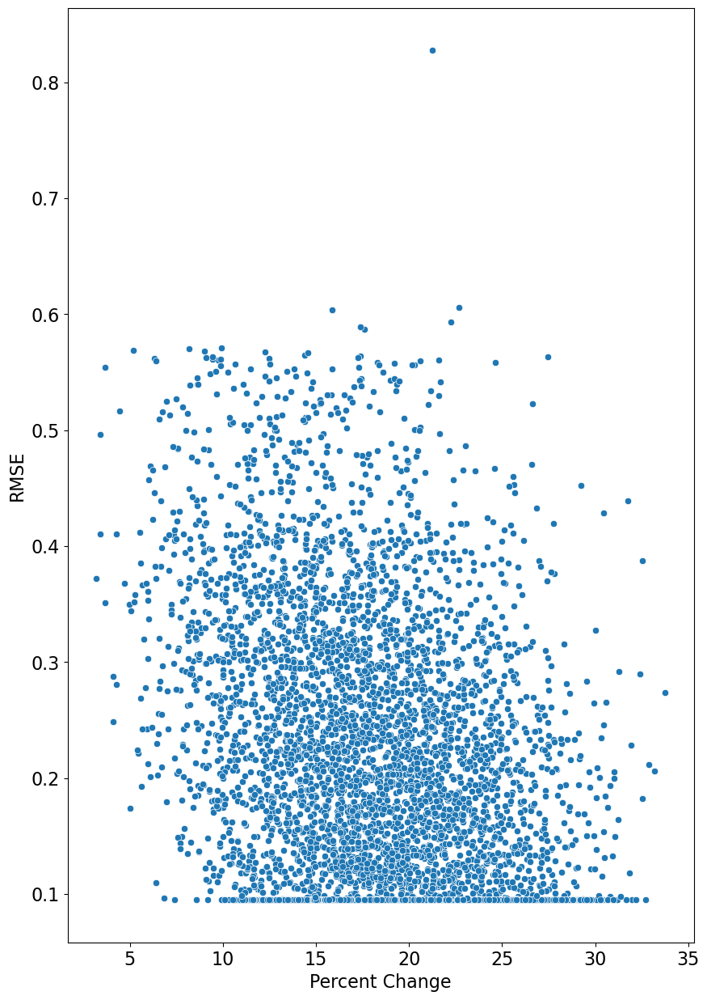

In [22]:
fig, ax = plt.subplots(figsize=(10, 15))

# Plot the first line (mono culture data)
sns.scatterplot(x= mets_percent_diff_sum, y= rmse_list_reduced)
ax.set_xlabel('Percent Change')
ax.set_ylabel('RMSE')

In [23]:
#https://sirinnes.wordpress.com/2013/04/25/pareto-frontier-graphic-via-python/

def plot_pareto_frontier(Xs, Ys, index_df, maxX=False, maxY=False):
    '''Pareto frontier selection process'''

    pareto_front_sims =[]
    # since we reduced and filtered out sims that failed, need to reset index on Xs series or would get error
    Xs = Xs.reset_index(drop=True)
    sorted_list = sorted([[Xs[i], Ys[i]] for i in range(len(Xs))], reverse=maxY)
    pareto_front = [sorted_list[0]]
    for pair in sorted_list[1:]:
        if maxY:
            if pair[1] >= pareto_front[-1][1]:
                pareto_front.append(pair)
        else:
            if pair[1] <= pareto_front[-1][1]:
                pareto_front.append(pair)
    
    '''Plotting process'''
    fig, ax = plt.subplots(figsize=(15, 15))
    plt.scatter(Xs,Ys, s=2)
    pf_X = [pair[0] for pair in pareto_front]
    pf_Y = [pair[1] for pair in pareto_front]

    x_y_df = pd.DataFrame({'init_cond_p_ch':pf_X, 'rmse':pf_Y})

    merged_pareto_df = pd.merge(index_df, x_y_df, on=['init_cond_p_ch', 'rmse'], how='inner')
    #print(merged_pareto_df)

    plt.plot(pf_X, pf_Y, lw = 3, color = 'orange')
    plt.scatter(pf_X, pf_Y, s=50)

    for i in range(0, len(merged_pareto_df)):
        #print(i)
        plt.annotate(merged_pareto_df['sim_num'][i], (pf_X[i], pf_Y[i]), textcoords="offset points", xytext=(0,5), ha='center')

        pareto_front_sims.append(merged_pareto_df['sim_num'][i])

    plt.xlabel("Initial Conditions Sum of % Change")
    plt.ylabel("RMSE")
    plt.title('Pareto Frontier')
    plt.show()

    return pareto_front_sims

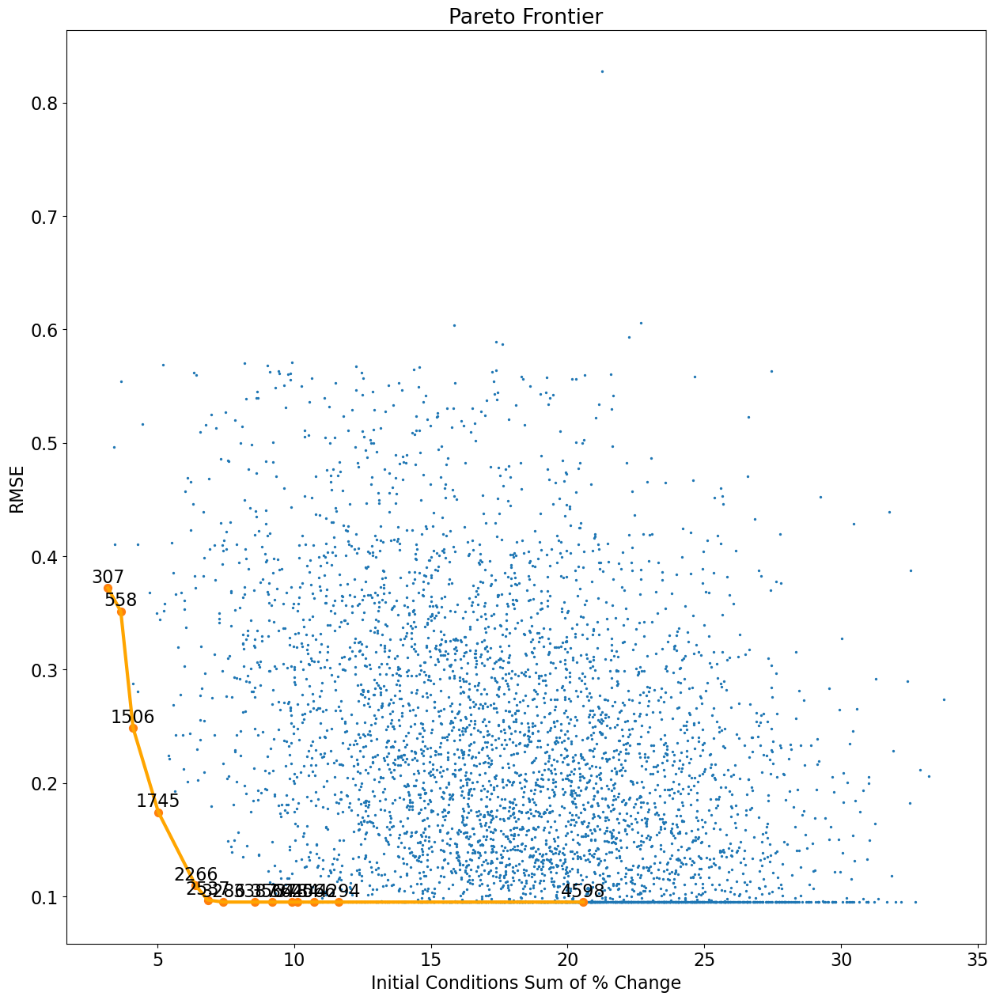

In [24]:
pareto_front_sims = plot_pareto_frontier(mets_percent_diff_sum, rmse_list_reduced, mets_percent_diff_sum_df)

In [25]:
## Make 


sim_rmse_df_co_pc = pd.DataFrame.from_dict(rmse_dict_eb_co, orient='index').reset_index()
sim_rmse_df_co_pc.columns = ['sim_num', 'rmse_pc_co']

sim_rmse_df_co_eb = pd.DataFrame.from_dict(rmse_dict_pc_co, orient='index').reset_index()
sim_rmse_df_co_eb.columns = ['sim_num', 'rmse_eb_co']


In [26]:
print(sim_rmse_df_co_pc.head())
print(sim_rmse_df_co_eb.head())

  sim_num rmse_pc_co
0       0         no
1       1    0.23256
2       2   0.163611
3       3   0.154474
4       4   0.516723
  sim_num rmse_eb_co
0       0         no
1       1   0.416571
2       2   0.401767
3       3   0.398754
4       4   0.067517


In [27]:
sim_rmse_df_co = sim_rmse_df_co_eb.copy()
sim_rmse_df_co['rmse_pc_co'] = sim_rmse_df_co_pc['rmse_pc_co']
sim_rmse_df_co

,sim_num,rmse_eb_co,rmse_pc_co
0,0,no,no
1,1,0.416571,0.23256
2,2,0.401767,0.163611
3,3,0.398754,0.154474
4,4,0.067517,0.516723
...,...,...,...
4995,4995,0.070039,0.359969
4996,4996,0.40533,0.176119
4997,4997,0.417784,0.240678
4998,4998,0.073214,0.450457


In [28]:
# ok now i have the combined rmse dataframe
sim_rmse_df_co['rmse_eb_mono'] = sim_rmse_df['rmse']
sim_rmse_df_co


sim_rmse_df_co_filt = sim_rmse_df_co[sim_rmse_df_co['rmse_eb_co'] != 'no']

In [29]:
# now need to filter the combined dataframe and then filter the percent difference metabolites and also calculate l2 norm score 


mets_percent_diff_df_filt = mets_percent_diff_df.iloc[:,sim_rmse_df_co[sim_rmse_df_co['rmse_eb_co'] != 'no'].index.to_list()]
mets_percent_diff_df_filt

,1,2,3,4,5,7,8,9,10,11,...,4990,4991,4992,4993,4994,4995,4996,4997,4998,4999
reaction,,,,,,,,,,,,,,,,,,,,,
EX_adocbl(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_btn(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_h2s(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_ribflv(e),1.914165,3.813965,5.970322,7.403100,2.483105,5.263770,2.029030,7.324111,4.459720,1.128471,...,8.521511,6.327532,1.416569,3.683556,6.906516,0.741447,5.362743,1.660807,0.376081,8.718813
EX_thymd(e),8.925089,5.608042,6.206591,2.812661,3.644306,2.724597,2.098507,8.358042,4.198825,0.052401,...,5.564151,5.777504,2.731244,3.921021,5.977201,6.393952,4.720928,8.485055,4.809870,1.232957
EX_thm(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_spmd(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_sheme(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EX_q8(e),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [30]:
mets_percent_diff_sum = mets_percent_diff_df_filt.sum()
mets_percent_diff_sum_df = pd.DataFrame(mets_percent_diff_sum)
mets_percent_diff_sum_df['rmse'] = rmse_list_reduced_pc_co
mets_percent_diff_sum_df.columns = ['init_cond_p_ch', 'rmse']
mets_percent_diff_sum_df['sim_num'] = mets_percent_diff_sum_df.index
mets_percent_diff_sum_df.head()

,init_cond_p_ch,rmse,sim_num
1,21.115250,0.416571,1
2,13.862912,0.401767,2
3,22.031903,0.398754,3
4,18.288668,0.067517,4
5,18.951078,0.406777,5


In [31]:
sim_rmse_df_co_filt = sim_rmse_df_co_filt.reset_index(drop=True)
sim_rmse_df_co_filt['sim_num'] = np.int64(sim_rmse_df_co_filt['sim_num']) 

In [32]:
# Perform L2 regularization 

sim_rmse_df_co_filt['l2_reg_co_rmse'] = (sim_rmse_df_co_filt['rmse_eb_co']**2 + sim_rmse_df_co_filt['rmse_pc_co']**2)**.5

In [33]:
sim_rmse_df_master = sim_rmse_df_co_filt.merge(mets_percent_diff_sum_df, how='inner', on ='sim_num')

Text(0.5, 0, 'L2 Norm Co RMSE')

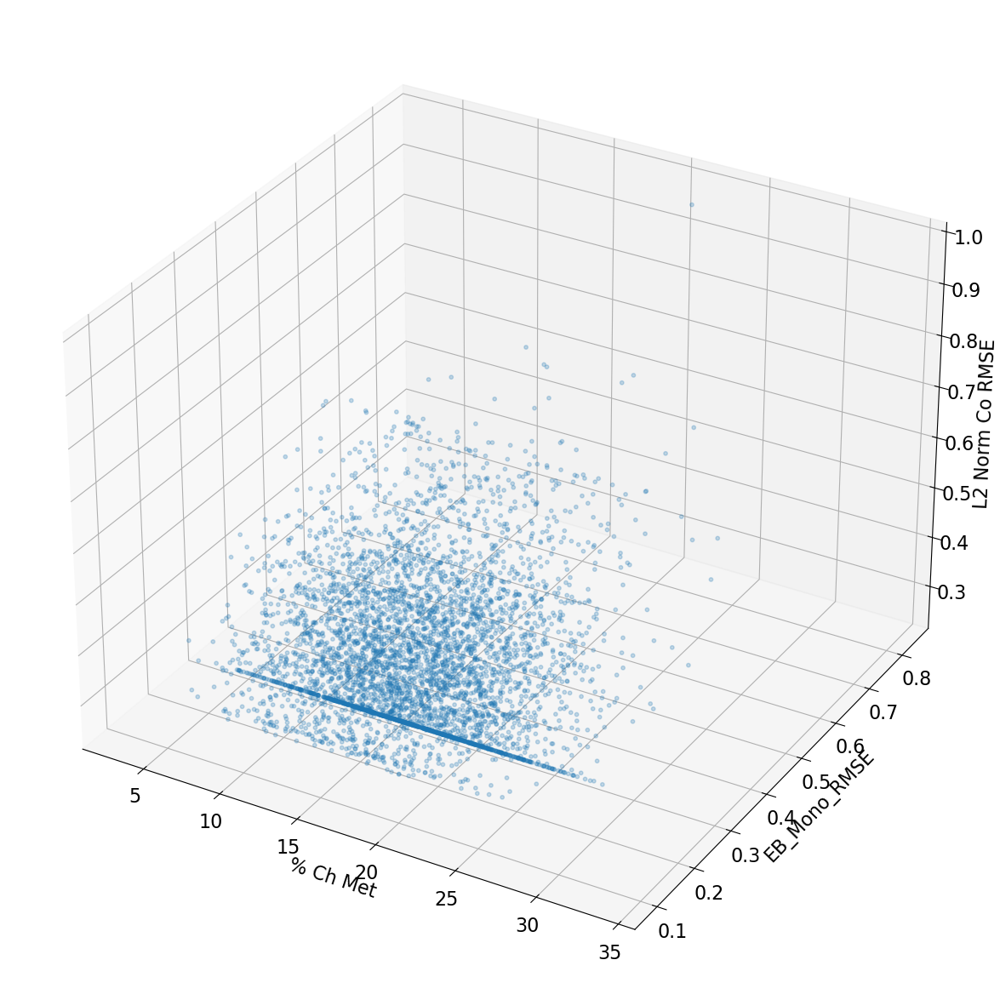

In [34]:
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(projection='3d')

ax.scatter(sim_rmse_df_master['init_cond_p_ch'], sim_rmse_df_master['rmse_eb_mono'], sim_rmse_df_master['l2_reg_co_rmse'], s =10, alpha = .25)
ax.set_xlabel('% Ch Met')
ax.set_ylabel('EB_Mono_RMSE')
ax.set_zlabel('L2 Norm Co RMSE')

In [34]:
fig = px.scatter_3d(sim_rmse_df_master, x='init_cond_p_ch', y='rmse_eb_mono', z='l2_reg_co_rmse')
fig.show()

In [35]:
from paretoset import paretoset

In [36]:
sim_rmse_df_master.head()

,sim_num,rmse_eb_co,rmse_pc_co,rmse_eb_mono,l2_reg_co_rmse,init_cond_p_ch,rmse
0,1,0.416571,0.23256,0.180621,0.477091,21.115250,0.416571
1,2,0.401767,0.163611,0.106871,0.433803,13.862912,0.401767
2,3,0.398754,0.154474,0.097047,0.427629,22.031903,0.398754
3,4,0.067517,0.516723,0.482424,0.521115,18.288668,0.067517
4,5,0.406777,0.181834,0.126453,0.445569,18.951078,0.406777


In [37]:
sim_rmse_df_master_reduced = sim_rmse_df_master.drop(columns=['rmse', 'sim_num', 'rmse_eb_co', 'rmse_pc_co'])

In [38]:
sim_rmse_df_master_reduced['l2_reg_co_rmse'] = np.float64(sim_rmse_df_master_reduced['l2_reg_co_rmse'])

In [39]:
mask = paretoset(sim_rmse_df_master_reduced, sense =['min', 'min', 'min'])

In [40]:
sim_rmse_df_master['pareto'] = mask
sim_rmse_df_master.head()

,sim_num,rmse_eb_co,rmse_pc_co,rmse_eb_mono,l2_reg_co_rmse,init_cond_p_ch,rmse,pareto
0,1,0.416571,0.23256,0.180621,0.477091,21.115250,0.416571,False
1,2,0.401767,0.163611,0.106871,0.433803,13.862912,0.401767,False
2,3,0.398754,0.154474,0.097047,0.427629,22.031903,0.398754,False
3,4,0.067517,0.516723,0.482424,0.521115,18.288668,0.067517,False
4,5,0.406777,0.181834,0.126453,0.445569,18.951078,0.406777,False


In [41]:
sim_rmse_df_master_pareto_filt = sim_rmse_df_master[sim_rmse_df_master['pareto'] == True]

In [43]:
X, Y = np.meshgrid(sim_rmse_df_master_pareto_filt['init_cond_p_ch'], sim_rmse_df_master_pareto_filt['rmse_eb_mono'])

AttributeError: 'list' object has no attribute 'ndim'

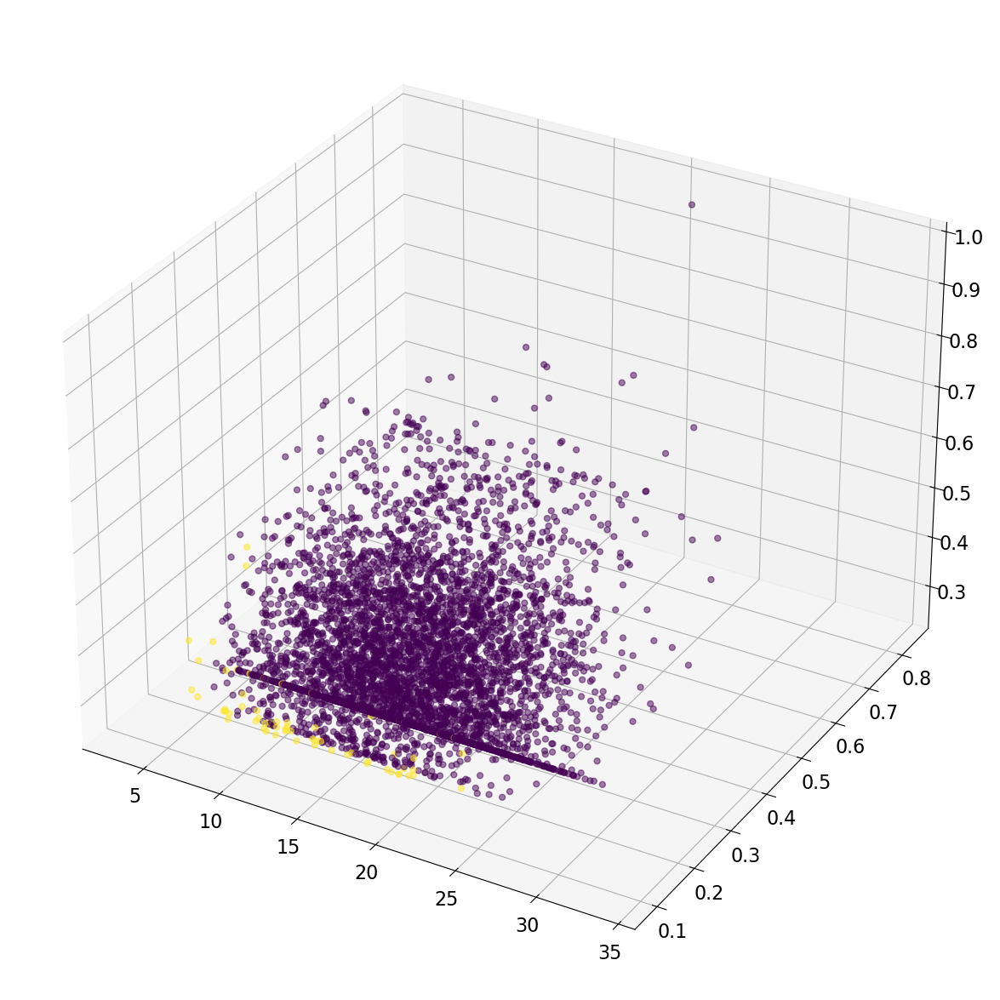

In [44]:
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(projection='3d')

ax.scatter(sim_rmse_df_master['init_cond_p_ch'], sim_rmse_df_master['rmse_eb_mono'], sim_rmse_df_master['l2_reg_co_rmse'], c = sim_rmse_df_master['pareto'],  s =25, alpha = .5)
ax.plot_surface(sim_rmse_df_master_pareto_filt['init_cond_p_ch'].to_list(), sim_rmse_df_master_pareto_filt['rmse_eb_mono'].to_list(), sim_rmse_df_master['l2_reg_co_rmse'].to_list(), antialiased=False)
ax.set_xlabel('% Ch Met')
ax.set_ylabel('EB_Mono_RMSE')
ax.set_zlabel('L2 Norm Co RMSE')

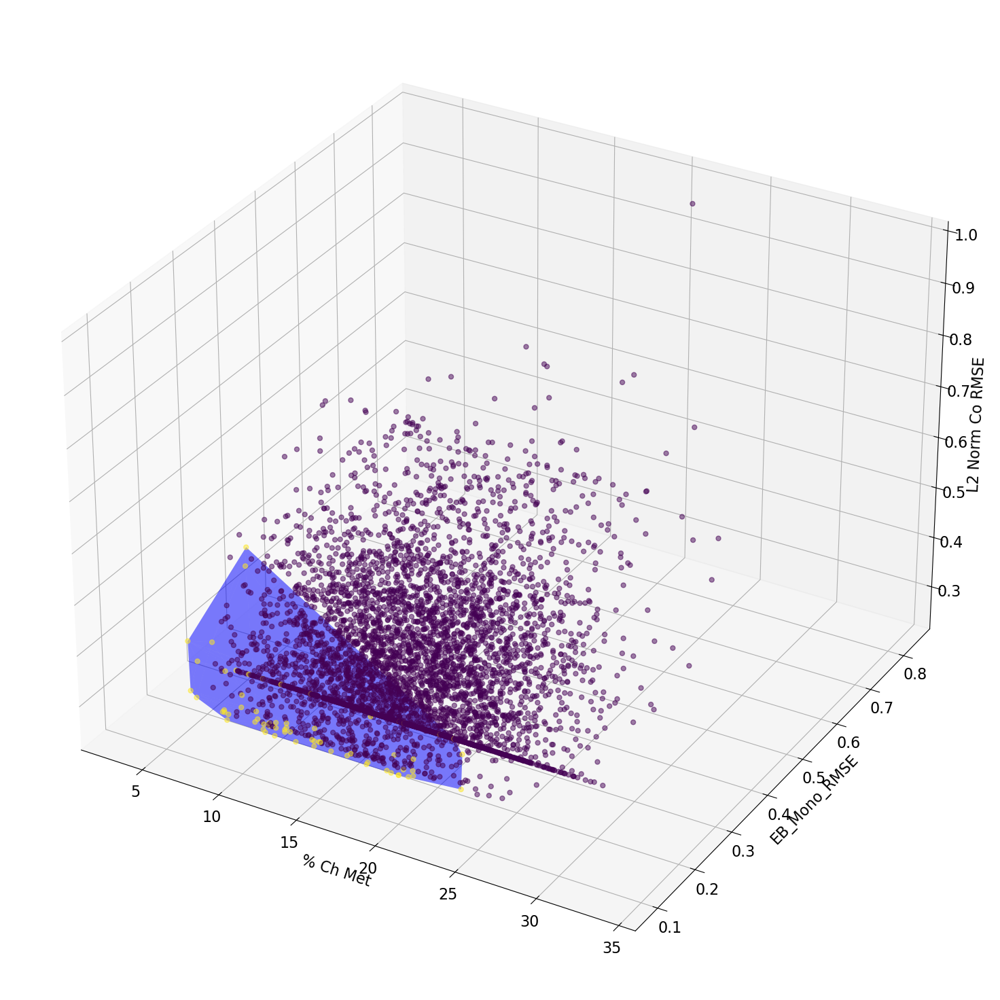

In [42]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull
from matplotlib import cm

# Create figure
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection='3d')

# Plot all data points, colored by pareto flag
scatter = ax.scatter(
    sim_rmse_df_master['init_cond_p_ch'], 
    sim_rmse_df_master['rmse_eb_mono'], 
    sim_rmse_df_master['l2_reg_co_rmse'], 
    c=sim_rmse_df_master['pareto'],
    s=25, 
    alpha=0.5
)

# Filter only Pareto points
pareto_points = sim_rmse_df_master[sim_rmse_df_master['pareto'] == True]

# Extract coordinates of Pareto points
x = pareto_points['init_cond_p_ch'].values
y = pareto_points['rmse_eb_mono'].values
z = pareto_points['l2_reg_co_rmse'].values

# Create a convex hull of the Pareto points
if len(x) >= 4:  # Need at least 4 points for a 3D convex hull
    points = np.vstack([x, y, z]).T
    hull = ConvexHull(points)
    
    # Get triangulation from the convex hull
    simplices = hull.simplices
    
    # Create a list of triangles (vertices)
    triangles = []
    for simplex in simplices:
        triangles.append([points[simplex[0]], points[simplex[1]], points[simplex[2]]])
    
    # Plot each triangular face manually with Poly3DCollection
    from mpl_toolkits.mplot3d.art3d import Poly3DCollection
    
    # Turn off shading to avoid the error
    poly = Poly3DCollection(triangles, alpha=0.3, color='blue', edgecolor='none', shade=False)
    ax.add_collection3d(poly)
else:
    # If not enough points for convex hull, just connect them with lines
    ax.plot(x, y, z, 'r-', alpha=0.5)

# Set labels
ax.set_xlabel('% Ch Met')
ax.set_ylabel('EB_Mono_RMSE')
ax.set_zlabel('L2 Norm Co RMSE')

plt.tight_layout()
plt.show()

In [84]:
import plotly.graph_objects as go
import numpy as np
from scipy.spatial import ConvexHull
from scipy.interpolate import griddata

# Create a figure
fig = go.Figure()

# Add scatter points for all data
fig.add_trace(go.Scatter3d(
    x=sim_rmse_df_master['init_cond_p_ch'],
    y=sim_rmse_df_master['rmse_eb_mono'],
    z=sim_rmse_df_master['l2_reg_co_rmse'],
    mode='markers',
    marker=dict(
        size=2,
        color=sim_rmse_df_master['pareto'].astype(int),  # Convert boolean to int for coloring
        colorscale=[[0, 'blue'], [1, 'red']],  # Blue for non-Pareto, red for Pareto
        opacity=0.2
    ),
    name='All Points'
))

# Filter only Pareto points
pareto_points = sim_rmse_df_master[sim_rmse_df_master['pareto'] == True]

# Extract coordinates of Pareto points
x = pareto_points['init_cond_p_ch'].values
y = pareto_points['rmse_eb_mono'].values
z = pareto_points['l2_reg_co_rmse'].values
pareto_sims = np.int64(pareto_points['sim_num'].values)

# Create a 2D surface for the Pareto front
if len(x) >= 4:
    # Create a grid for interpolation
    xi = np.linspace(min(x), max(x), 50)
    yi = np.linspace(min(y), max(y), 50)
    X, Y = np.meshgrid(xi, yi)
    
    # Interpolate z values over the grid
    points = np.vstack((x, y)).T
    Z = griddata(points, z, (X, Y), method='linear')
    
    color1 = 'orange'

    # Create the surface
    fig.add_trace(go.Surface(
        x=X,
        y=Y,
        z=Z,
        colorscale=[[0, color1], [1,color1]],
        opacity=0.8,
        showscale=False,
        name='Pareto Surface'
    ))
    
    # Add scatter points just for the Pareto optimal points to make them stand out
    fig.add_trace(go.Scatter3d(
        x=x, y=y, z=z,
        hovertext=[f"sim_num={v:.3f}" for v in pareto_sims],
        mode='markers',
        marker=dict(
            size=7,
            color='red',
            symbol='circle'
        ),
        name='Pareto Points'
    ))

# Update the layout to make the figure cube-shaped
fig.update_layout(
    title='3D Pareto Front with 2D Surface',
    scene=dict(
        xaxis_title='% Ch Met',
        yaxis_title='EB_Mono_RMSE',
        zaxis_title='L2 Norm Co RMSE',
        aspectmode='cube'  # Make the display cube-shaped
    ),
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    ),
    margin=dict(l=0, r=0, b=0, t=30),
    height=800,
    width=800  # Match height for a perfect cube display
)




# Show the figure
fig.show()

In [44]:
# extract and plot curves for pareto points 

sim_rmse_df_master_pareto_filt

,sim_num,rmse_eb_co,rmse_pc_co,rmse_eb_mono,l2_reg_co_rmse,init_cond_p_ch,rmse,pareto
26,32,0.265397,0.175169,0.108117,0.317993,10.681367,0.265397,True
40,48,0.38436,0.152447,0.095041,0.413489,18.456102,0.384360,True
292,307,0.067517,0.411313,0.371967,0.416818,3.185318,0.067517,True
395,415,0.39321,0.151266,0.095041,0.421302,22.793007,0.393210,True
482,505,0.176285,0.207856,0.155501,0.272545,13.085857,0.176285,True
...,...,...,...,...,...,...,...,...
4234,4393,0.204849,0.197476,0.132415,0.284535,10.545193,0.204849,True
4294,4457,0.178366,0.206466,0.142173,0.272842,19.595075,0.178366,True
4430,4598,0.39321,0.151266,0.095041,0.421302,11.632091,0.393210,True
4755,4934,0.131522,0.229947,0.185903,0.264903,17.581406,0.131522,True


In [45]:
pareto_sims_list = sim_rmse_df_master_pareto_filt['sim_num'].to_list()
pareto_sims_list = [str(number) for number in pareto_sims_list]
pareto_file_name = 'pareto_sims.csv'


In [101]:
np.savetxt(os.path.join(MC_directory, pareto_file_name), pareto_sims_list, fmt='%s',delimiter=',', header = 'sim_num')

In [47]:
### read in MC data

### Reading in all of the data from the simulation 

abun_to_store_eb_mono =[]
#met_to_store =[]
temp_abun = []
#temp_met =[]


for i in range(0,5000):
    
    temp_dir = MC_directory + '/EB_mono_pareto_sims/sim_' + str(i)
    print(temp_dir)
    if os.path.exists(temp_dir):
        #met = temp_dir + '/met_pool_over_time.npy'
        abun = temp_dir + '/model_abun_dict.npy'
        #met = np.load(met, allow_pickle=True)
        abun = np.load(abun, allow_pickle=True)
        #temp_met.append(met)
        temp_abun.append(abun.item())
abun_to_store_eb_mono.append(temp_abun)
#met_to_store.append(temp_met)  

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_0
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_1
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_2
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_3
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_4
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_5
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_mono_pareto_sims/sim_6

In [48]:
### read in MC data

### Reading in all of the data from the simulation 

abun_to_store_eb_pc_co =[]
#met_to_store =[]
temp_abun = []
#temp_met =[]


for i in range(0,5000):
    
    temp_dir = MC_directory + '/EB_PC_co_pareto_sims/sim_' + str(i)
    print(temp_dir)
    if os.path.exists(temp_dir):
        #met = temp_dir + '/met_pool_over_time.npy'
        abun = temp_dir + '/model_abun_dict.npy'
        #met = np.load(met, allow_pickle=True)
        abun = np.load(abun, allow_pickle=True)
        #temp_met.append(met)
        temp_abun.append(abun.item())
abun_to_store_eb_pc_co.append(temp_abun)
#met_to_store.append(temp_met)  

/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_0
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_1
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_2
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_3
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_4
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sims/sim_5
/Users/haydengallo/UMass_Dropbox/Dropbox (UMass Medical School)/Bucci_Lab/glv_FBA/MC_sensitivity_analysis/EB_PC_co_1/EB_PC_co_pareto_sim

In [53]:
eb_mono_array_fba_biomass = np.zeros([len(abun_to_store_eb_mono[0][0]['eb']['fba_biomass']),len(abun_to_store_eb_mono[0])])
eb_co_array_fba_biomass = np.zeros([len(abun_to_store_eb_pc_co[0][0]['eb']['fba_biomass']),len(abun_to_store_eb_pc_co[0])])
pc_co_array_fba_biomass = np.zeros([len(abun_to_store_eb_pc_co[0][0]['eb']['fba_biomass']),len(abun_to_store_eb_pc_co[0])])

for i in range(0, len(abun_to_store_eb_mono[0])):
    eb_mono_array_fba_biomass[:,i] = abun_to_store_eb_mono[0][i]['eb']['fba_biomass']
    eb_co_array_fba_biomass[:,i] = abun_to_store_eb_pc_co[0][i]['eb']['fba_biomass']
    pc_co_array_fba_biomass[:,i] = abun_to_store_eb_pc_co[0][i]['p_copri']['fba_biomass']


abun_to_store[0] length: 0
eb_array_fba_biomass shape: (577, 65)
Column 0 min: 0.005, max: 1.5690425862175623
Column 1 min: 0.005, max: 1.5913864073703619
Column 2 min: 0.005, max: 1.1844354503135888
Column 3 min: 0.005, max: 1.591387399048767
Column 4 min: 0.005, max: 1.493387531181353
Column 5 min: 0.005, max: 1.356159033737599
Column 6 min: 0.005, max: 1.53961598827015
Column 7 min: 0.005, max: 1.5705782674661102
Column 8 min: 0.005, max: 1.5164428812160065
Column 9 min: 0.005, max: 1.5355788211207395
Column 10 min: 0.005, max: 1.59138658922618
Column 11 min: 0.005, max: 1.4488639750271224
Column 12 min: 0.005, max: 1.5913865840521195
Column 13 min: 0.005, max: 1.4870947743016798
Column 14 min: 0.005, max: 1.5664654273217344
Column 15 min: 0.005, max: 1.5252691231240814
Column 16 min: 0.005, max: 1.5048172401015496
Column 17 min: 0.005, max: 1.5913864027035067
Column 18 min: 0.005, max: 1.566565092082753
Column 19 min: 0.005, max: 1.5219270523926165
Column 20 min: 0.005, max: 1.4932

<>:6: SyntaxWarning:

invalid escape sequence '\i'

<>:24: SyntaxWarning:

invalid escape sequence '\i'

<>:6: SyntaxWarning:

invalid escape sequence '\i'

<>:24: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/3408620114.py:6: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/3408620114.py:24: SyntaxWarning:

invalid escape sequence '\i'



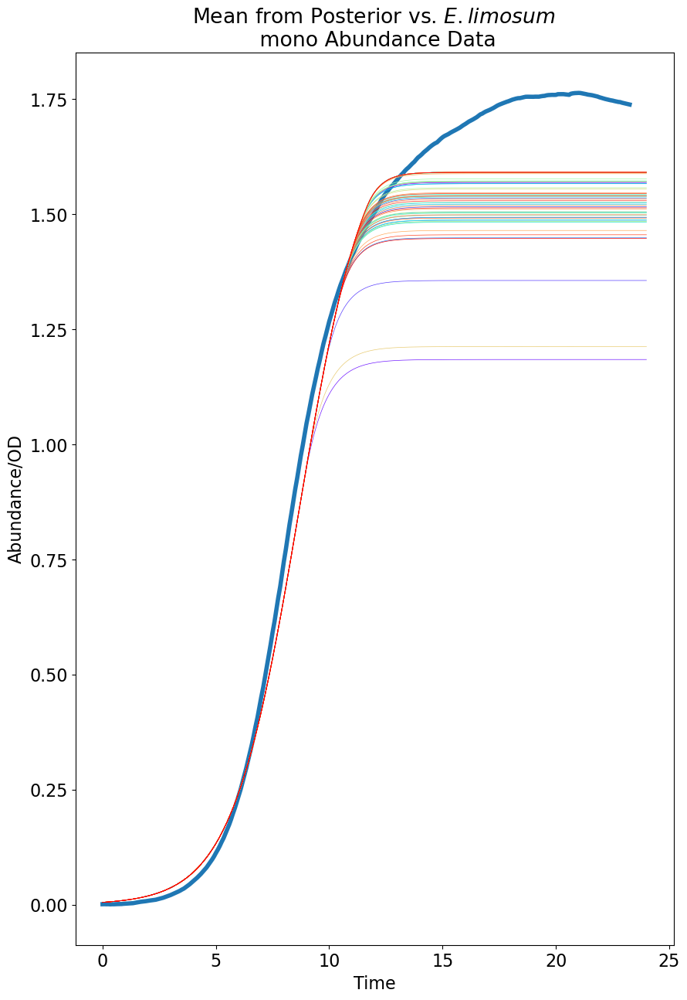

In [65]:
### ok now plot sims vs experimental

fig, ax = plt.subplots(figsize=(10, 15))

# Plot the first line (mono culture data)
ax.plot(EB_mono_culture_df['Time'], EB_mono_culture_df['OD'], label='Mean $\it{E. limosum}$ Abun')

# Print the shapes to diagnose the issue
print(f"abun_to_store[0] length: {len(abun_to_store[0])}")
print(f"eb_array_fba_biomass shape: {eb_mono_array_fba_biomass.shape}")

# Plot each column of eb_array_fba_biomass with different colors
colors = plt.cm.rainbow(np.linspace(0, 1, eb_mono_array_fba_biomass.shape[1]))

for i in range(eb_mono_array_fba_biomass.shape[1]):
    label = pareto_sims_list[i] if i < len(pareto_sims_list) else f"Sample {i}"
    ax.plot(time_integration, eb_mono_array_fba_biomass[:, i], 
            label=label, color=colors[i], lw=0.5)
    
    # Print range of values to help diagnose
    print(f"Column {i} min: {eb_mono_array_fba_biomass[:, i].min()}, max: {eb_mono_array_fba_biomass[:, i].max()}")

# Add proper labels
ax.set_title('Mean from Posterior vs. $\it{E. limosum}$ \n mono Abundance Data')
ax.set_xlabel('Time')
ax.set_ylabel('Abundance/OD')

# Add legend for only a few lines to avoid overcrowding
#handles, labels = ax.get_legend_handles_labels()
#if len(handles) > 10:
#    ax.legend([handles[0]] + handles[1:4], [labels[0]] + ["Model samples"] * 3)
#else:
#    ax.legend()

plt.show()


In [61]:
co_culture_df[co_culture_df['Group_together'] == 'EUBwPC']

,Group_together,Time,OD
840,EUBwPC,0.00,0.000483
841,EUBwPC,0.09,0.001217
842,EUBwPC,0.17,0.001867
843,EUBwPC,0.25,0.002383
844,EUBwPC,0.34,0.002767
...,...,...,...
1115,EUBwPC,22.92,1.857167
1116,EUBwPC,23.01,1.857567
1117,EUBwPC,23.09,1.858083
1118,EUBwPC,23.17,1.858400


abun_to_store[0] length: 0
eb_array_fba_biomass shape: (577, 65)
Column 0 min: 0.005, max: 1.5690425862175623
Column 1 min: 0.005, max: 1.5913864073703619
Column 2 min: 0.005, max: 1.1844354503135888
Column 3 min: 0.005, max: 1.591387399048767
Column 4 min: 0.005, max: 1.493387531181353
Column 5 min: 0.005, max: 1.356159033737599
Column 6 min: 0.005, max: 1.53961598827015
Column 7 min: 0.005, max: 1.5705782674661102
Column 8 min: 0.005, max: 1.5164428812160065
Column 9 min: 0.005, max: 1.5355788211207395
Column 10 min: 0.005, max: 1.59138658922618
Column 11 min: 0.005, max: 1.4488639750271224
Column 12 min: 0.005, max: 1.5913865840521195
Column 13 min: 0.005, max: 1.4870947743016798
Column 14 min: 0.005, max: 1.5664654273217344
Column 15 min: 0.005, max: 1.5252691231240814
Column 16 min: 0.005, max: 1.5048172401015496
Column 17 min: 0.005, max: 1.5913864027035067
Column 18 min: 0.005, max: 1.566565092082753
Column 19 min: 0.005, max: 1.5219270523926165
Column 20 min: 0.005, max: 1.4932

<>:6: SyntaxWarning:

invalid escape sequence '\i'

<>:7: SyntaxWarning:

invalid escape sequence '\i'

<>:28: SyntaxWarning:

invalid escape sequence '\i'

<>:6: SyntaxWarning:

invalid escape sequence '\i'

<>:7: SyntaxWarning:

invalid escape sequence '\i'

<>:28: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/588258640.py:6: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/588258640.py:7: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/588258640.py:28: SyntaxWarning:

invalid escape sequence '\i'



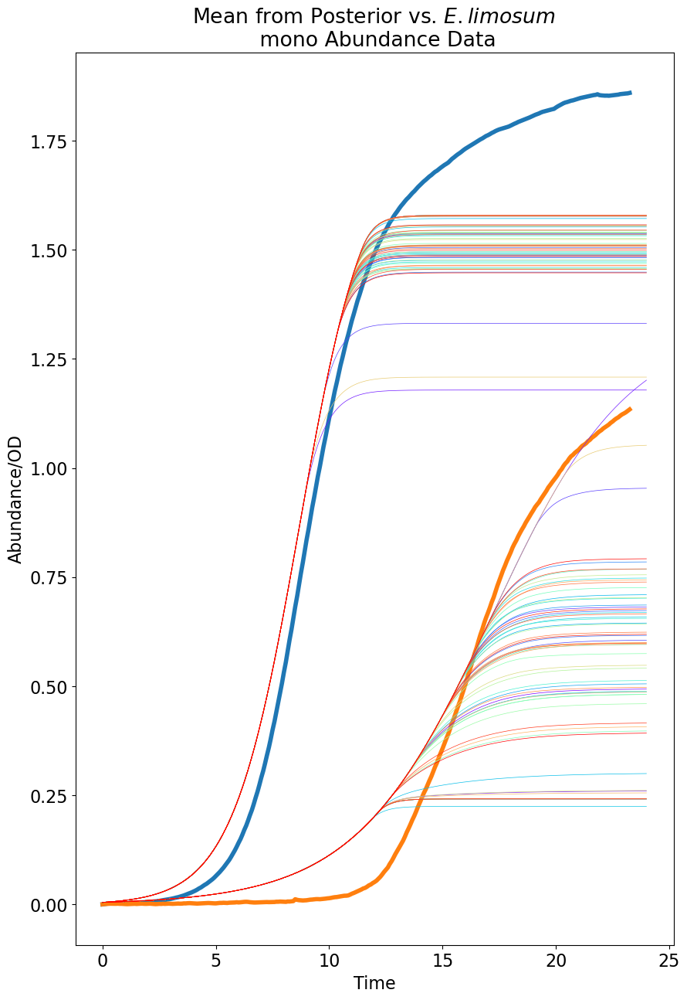

In [66]:
### ok now plot sims vs experimental

fig, ax = plt.subplots(figsize=(10, 15))

# Plot the first line (mono culture data)
ax.plot(co_culture_df[co_culture_df['Group_together'] == 'EUBwPC']['Time'], co_culture_df[co_culture_df['Group_together'] == 'EUBwPC']['OD'], label='Mean $\it{E. limosum}$ Abun')
ax.plot(co_culture_df[co_culture_df['Group_together'] == 'PCwEUB']['Time'], co_culture_df[co_culture_df['Group_together'] == 'PCwEUB']['OD'], label='Mean $\it{E. limosum}$ Abun')


# Print the shapes to diagnose the issue
print(f"abun_to_store[0] length: {len(abun_to_store[0])}")
print(f"eb_array_fba_biomass shape: {eb_mono_array_fba_biomass.shape}")

# Plot each column of eb_array_fba_biomass with different colors
colors = plt.cm.rainbow(np.linspace(0, 1, eb_mono_array_fba_biomass.shape[1]))

for i in range(eb_mono_array_fba_biomass.shape[1]):
    label = pareto_sims_list[i] if i < len(pareto_sims_list) else f"Sample {i}"
    ax.plot(time_integration, eb_co_array_fba_biomass[:, i], 
            label=label, color=colors[i], lw=0.5)
    ax.plot(time_integration, pc_co_array_fba_biomass[:, i], 
            label=label, color=colors[i], lw=0.5)
    
    # Print range of values to help diagnose
    print(f"Column {i} min: {eb_mono_array_fba_biomass[:, i].min()}, max: {eb_mono_array_fba_biomass[:, i].max()}")

# Add proper labels
ax.set_title('Mean from Posterior vs. $\it{E. limosum}$ \n mono Abundance Data')
ax.set_xlabel('Time')
ax.set_ylabel('Abundance/OD')

# Add legend for only a few lines to avoid overcrowding
handles, labels = ax.get_legend_handles_labels()
#if len(handles) > 10:
#    ax.legend([handles[0]] + handles[1:4], [labels[0]] + ["Model samples"] * 3)
#else:
#    ax.legend()

#plt.show()


<>:25: SyntaxWarning:

invalid escape sequence '\i'

<>:26: SyntaxWarning:

invalid escape sequence '\i'

<>:38: SyntaxWarning:

invalid escape sequence '\i'

<>:25: SyntaxWarning:

invalid escape sequence '\i'

<>:26: SyntaxWarning:

invalid escape sequence '\i'

<>:38: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/2425188197.py:25: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/2425188197.py:26: SyntaxWarning:

invalid escape sequence '\i'

/var/folders/5n/y6k0c8y951n38r8ccc6trh1m0000gn/T/ipykernel_42919/2425188197.py:38: SyntaxWarning:

invalid escape sequence '\i'



abun_to_store[0] length: 0
eb_array_fba_biomass shape: (577, 65)
Column 0 min: 0.005, max: 1.5690425862175623
Column 1 min: 0.005, max: 1.5913864073703619
Column 2 min: 0.005, max: 1.1844354503135888
Column 3 min: 0.005, max: 1.591387399048767
Column 4 min: 0.005, max: 1.493387531181353
Column 5 min: 0.005, max: 1.356159033737599
Column 6 min: 0.005, max: 1.53961598827015
Column 7 min: 0.005, max: 1.5705782674661102
Column 8 min: 0.005, max: 1.5164428812160065
Column 9 min: 0.005, max: 1.5355788211207395
Column 10 min: 0.005, max: 1.59138658922618
Column 11 min: 0.005, max: 1.4488639750271224
Column 12 min: 0.005, max: 1.5913865840521195
Column 13 min: 0.005, max: 1.4870947743016798
Column 14 min: 0.005, max: 1.5664654273217344
Column 15 min: 0.005, max: 1.5252691231240814
Column 16 min: 0.005, max: 1.5048172401015496
Column 17 min: 0.005, max: 1.5913864027035067
Column 18 min: 0.005, max: 1.566565092082753
Column 19 min: 0.005, max: 1.5219270523926165
Column 20 min: 0.005, max: 1.4932

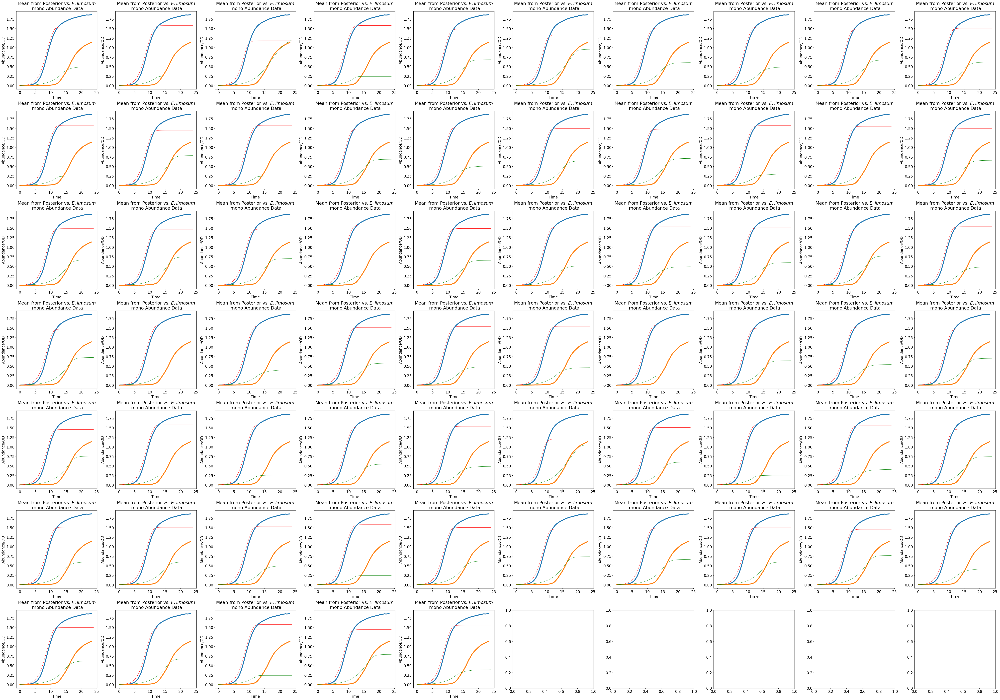

In [87]:
### ok now plot sims vs experimental

num_plots = eb_mono_array_fba_biomass.shape[1]
cols = 10  # Number of columns in the grid
rows = (num_plots + cols - 1) // cols  # Calculate number of rows needed

fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows *6), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()




# Print the shapes to diagnose the issue
print(f"abun_to_store[0] length: {len(abun_to_store[0])}")
print(f"eb_array_fba_biomass shape: {eb_mono_array_fba_biomass.shape}")

# Plot each column of eb_array_fba_biomass with different colors
colors = plt.cm.rainbow(np.linspace(0, 1, eb_mono_array_fba_biomass.shape[1]))

for i in range(eb_mono_array_fba_biomass.shape[1]):
    
    # Plot the first line (mono culture data)
    axes[i].plot(co_culture_df[co_culture_df['Group_together'] == 'EUBwPC']['Time'], co_culture_df[co_culture_df['Group_together'] == 'EUBwPC']['OD'], label='Mean $\it{E. limosum}$ Abun')
    axes[i].plot(co_culture_df[co_culture_df['Group_together'] == 'PCwEUB']['Time'], co_culture_df[co_culture_df['Group_together'] == 'PCwEUB']['OD'], label='Mean $\it{E. limosum}$ Abun')
    label = pareto_sims_list[i] if i < len(pareto_sims_list) else f"Sample {i}"
    axes[i].plot(time_integration, eb_co_array_fba_biomass[:, i], 
            label=label, color='red', lw=0.8)
    axes[i].plot(time_integration, pc_co_array_fba_biomass[:, i], 
            label=label, color='green', lw=0.8)
    
    # Print range of values to help diagnose
    print(f"Column {i} min: {eb_mono_array_fba_biomass[:, i].min()}, max: {eb_mono_array_fba_biomass[:, i].max()}")

    
    # Add proper labels
    axes[i].set_title('Mean from Posterior vs. $\it{E. limosum}$ \n mono Abundance Data')
    axes[i].set_xlabel('Time')
    axes[i].set_ylabel('Abundance/OD')

# Add legend for only a few lines to avoid overcrowding
handles, labels = ax.get_legend_handles_labels()
#if len(handles) > 10:
#    ax.legend([handles[0]] + handles[1:4], [labels[0]] + ["Model samples"] * 3)
#else:
#    ax.legend()

#plt.show()


In [161]:
### trying to make function for truly generalized LV

### implementing naive gLV

def gLV(X, t, params):
    x, y = X 
    r_1, r_2, gamma_1, gamma_2, a_1, a_2 =  params

    # EB concentration integrated overtime
    dxdt = x * (r_1 + a_1*x + gamma_1*y)
    
    # P.copri concentration integrated overtime
    dydt = y * (r_2 + gamma_2*x + a_2*y)


    return [dxdt, dydt]






In [162]:
def generalized_LV(init_abun, t, int_matrix, basal_grow):


    return init_abun*(np.dot(init_abun,int_matrix) + basal_grow)

In [169]:
init_abun = [.002, .002]

### so far must manually set initial values of parameters
### also might want to manually specify bounds too, could be something good 

# monoculture growth rate of EB
r_1 = 0.04198
# monoculture growth rate of P. copri
r_2 = .115
# co culture growth rate of EB
gamma_1 = 5
# co culture growth rate of P. copri # should be small b/c p. copri grows pretty much the same with or without EB
gamma_2 = 0
# intraspecies competition of EB
a_1 = -10
# intraspecies competition of P. copri
a_2 = -2.9


params = np.array([r_1, r_2, gamma_1, gamma_2, a_1, a_2])
time = np.arange(0, 1000, .1)

In [170]:
basal_grow = np.array([r_1, r_2])

In [171]:
int_matrix = np.array([[a_1, gamma_2],[gamma_1, a_2]])

In [172]:
odeint(func=gLV, y0=init_abun, t=time, args=(params,))

array([[0.002     , 0.002     ],
       [0.00200641, 0.00202195],
       [0.00201285, 0.00204413],
       ...,
       [0.02402559, 0.03965517],
       [0.02402559, 0.03965517],
       [0.02402559, 0.03965517]])

In [173]:
odeint(func=generalized_LV, y0=init_abun, t=time, args=(int_matrix,basal_grow))

array([[0.002     , 0.002     ],
       [0.00200641, 0.00202195],
       [0.00201285, 0.00204413],
       ...,
       [0.02402559, 0.03965517],
       [0.02402559, 0.03965517],
       [0.02402559, 0.03965517]])

In [174]:
test_dot = np.dot(basal_grow,int_matrix)

In [128]:
basal_grow*(np.dot(basal_grow,int_matrix) + init_abun)

array([ 0.00659926, -0.0381225 ])